# Notebook de procesamiento de im&aacute;genes

In [1]:
# Importar libreria
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from scipy.ndimage import zoom
from moviepy.editor import VideoFileClip

## Numpy

In [2]:
an_array = np.array([[ 0,  0,  0,  0,  0,  0,  0,  0],
...                  [ 0,  0,  0,  9, 90, 99, 24,  0],
...                  [ 0,  0,  0, 30, 99, 99, 99,  0],
...                  [ 0,  0,  0,  0,  0,  0,  0,  0],
...                  [ 0,  0,  0, 70, 39, 89, 29,  0],
...                  [ 0,  0,  0, 90, 41, 99, 31,  0],
...                  [ 0,  0,  0, 99, 50, 60, 13,  0],
...                  [ 0,  0,  9, 20, 30, 94,  0,  0],
...                  [ 0,  0, 10, 50, 99, 78,  0,  0],
...                  [ 0,  0, 59, 37, 25, 11,  0,  0]])
print(an_array.shape)

(10, 8)


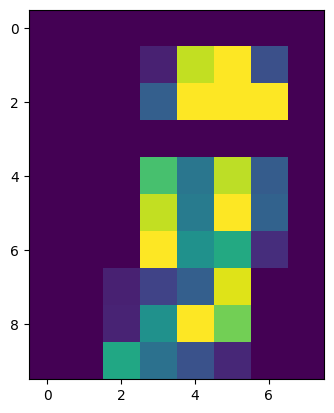

In [3]:
plt.imshow(an_array)

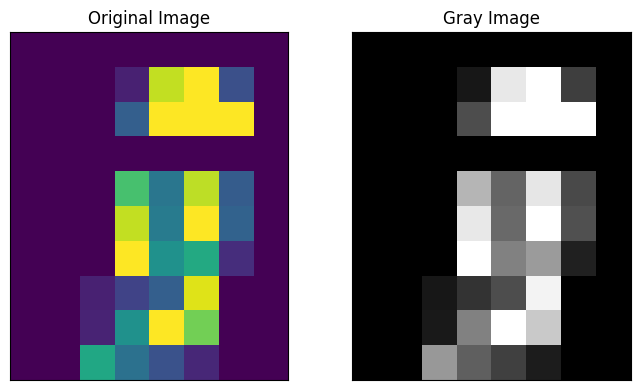

In [4]:
# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(7, 4))

# Plot the original image
axs[0].imshow(an_array)
axs[0].set_title('Original Image')

axs[1].imshow(an_array, cmap='gray')
axs[1].set_title('Gray Image')

# Remove ticks from the subplots
for ax in axs:
	ax.set_xticks([])
	ax.set_yticks([])

# Display the subplots
plt.tight_layout()
plt.show()

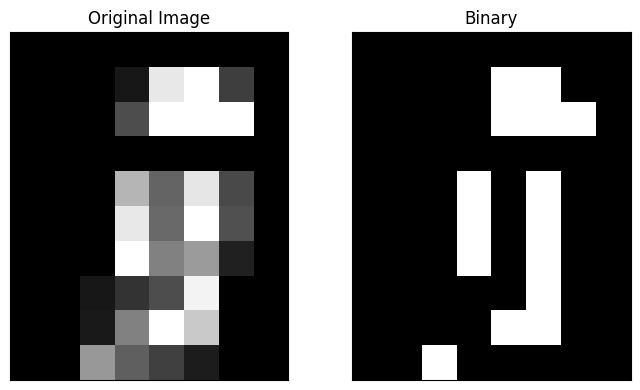

In [5]:
# Set 'gray' as the default colormap
plt.rcParams['image.cmap'] = 'gray'

# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(7, 4))

# Plot the original image
axs[0].imshow(an_array)
axs[0].set_title('Original Image')

axs[1].imshow(an_array > 50)
axs[1].set_title('Binary')

# Remove ticks from the subplots
for ax in axs:
	ax.set_xticks([])
	ax.set_yticks([])

# Display the subplots
plt.tight_layout()
plt.show()

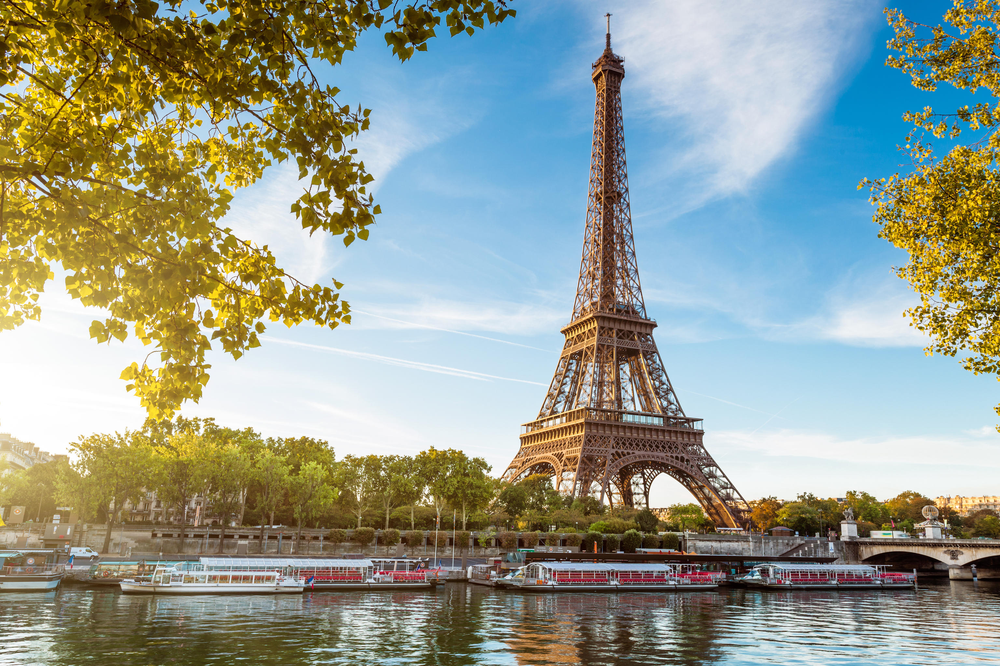

In [7]:
img = Image.open('eiffel.jpg')
img

In [8]:
# Se modifica el tamano
def resize_image(img, factor):
    return zoom(img, (factor, factor, 1)) 

resized_img = resize_image(img, 0.2)  

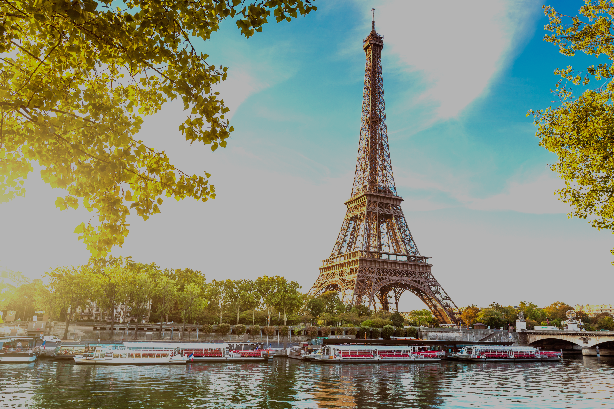

In [9]:
resized_img_uint8 = np.clip(resized_img, 0, 180).astype(np.uint8) #Se le modifica el brillo
resized_image_pil = Image.fromarray(resized_img_uint8)    
resized_image_pil

## OpenCV

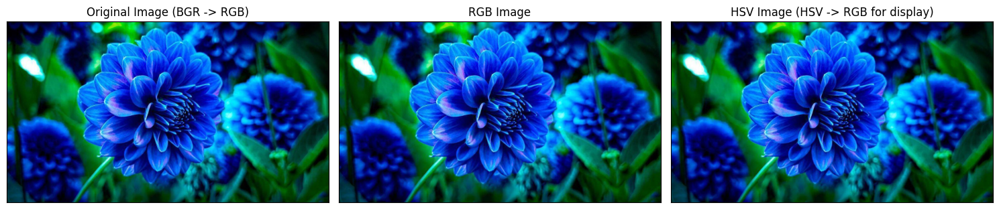

In [10]:
# Cargar la imagen
image = cv2.imread('flores.jpg')

# Verificar que la imagen ha sido cargada
if image is not None:
    # Convertir imagen BGR a RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Convertir imagen BGR a HSV, luego de HSV a RGB para visualización
    image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    image_hsv_to_rgb = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2RGB)

    # Crear subplots
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    # Plotear la imagen original (Convertir BGR a RGB para visualización correcta)
    axs[0].imshow(image_rgb)
    axs[0].set_title('Original Image (BGR -> RGB)')

    # Plotear la imagen en RGB
    axs[1].imshow(image_rgb)
    axs[1].set_title('RGB Image')

    # Plotear la imagen convertida de HSV a RGB
    axs[2].imshow(image_hsv_to_rgb)
    axs[2].set_title('HSV Image (HSV -> RGB for display)')

    # Remover ticks de los subplots
    for ax in axs:
        ax.set_xticks([])
        ax.set_yticks([])

    # Mostrar los subplots
    plt.tight_layout()
    plt.show()
else:
    print("Error: La imagen no se pudo cargar. Asegúrate de que la ruta está correcta.")


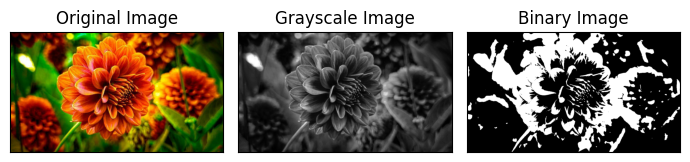

In [11]:
# Load the image
image = cv2.imread('flores.jpg')

# Use the cvtColor() function to grayscale the image 
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) 

# converting to its binary form 
ret,thresh = cv2.threshold(gray_image,70,255,0)

# Create subplots
fig, axs = plt.subplots(1, 3, figsize=(7, 4))

# Plot the original image
axs[0].imshow(image)
axs[0].set_title('Original Image')

# Plot Grayscale image
axs[1].imshow(gray_image, cmap='gray')
axs[1].set_title('Grayscale Image')

# Plot Binary image
axs[2].imshow(thresh, cmap='gray')
axs[2].set_title('Binary Image')

# Remove ticks from the subplots
for ax in axs:
	ax.set_xticks([])
	ax.set_yticks([])

# Display the subplots
plt.tight_layout()
plt.show()


In [12]:
Image.fromarray(image_rgb).save("flores.jpg", "jpeg")

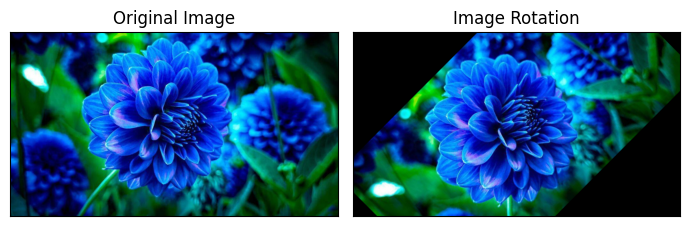

In [13]:
# Load the image
img = cv2.imread('flores.jpg')

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Image rotation parameter
center = (image_rgb.shape[1] // 2, image_rgb.shape[0] // 2)
angle = 45
scale = 1

# getRotationMatrix2D creates a matrix needed for transformation.
rotation_matrix = cv2.getRotationMatrix2D(center, angle, scale)

# We want matrix for rotation w.r.t center to 45 degree without scaling.
rotated_image = cv2.warpAffine(image_rgb, rotation_matrix, (image.shape[1], image.shape[0]))

# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(7, 4))

# Plot the original image
axs[0].imshow(image_rgb)
axs[0].set_title('Original Image')

# Plot the Rotated image
axs[1].imshow(rotated_image)
axs[1].set_title('Image Rotation')

# Remove ticks from the subplots
for ax in axs:
	ax.set_xticks([])
	ax.set_yticks([])

# Display the subplots
plt.tight_layout()
plt.show()


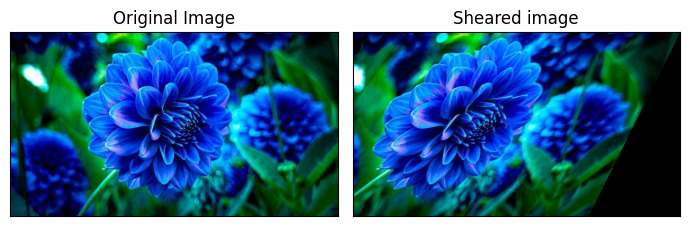

In [14]:
# Load the image
image = cv2.imread('flores.jpg')

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Image shape along X and Y
width = image_rgb.shape[1]
height = image_rgb.shape[0]

# Define the Shearing factor
shearX = -0.5
shearY = 0

# Define the Transformation matrix for shearing
transformation_matrix = np.array([[1, shearX, 0], 
								[0, 1, shearY]], dtype=np.float32)
# Apply shearing
sheared_image = cv2.warpAffine(image_rgb, transformation_matrix, (width, height))

# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(7, 4))

# Plot the original image
axs[0].imshow(image_rgb)
axs[0].set_title('Original Image')

# Plot the Sheared image
axs[1].imshow(sheared_image)
axs[1].set_title('Sheared image')

# Remove ticks from the subplots
for ax in axs:
	ax.set_xticks([])
	ax.set_yticks([])

# Display the subplots
plt.tight_layout()
plt.show()


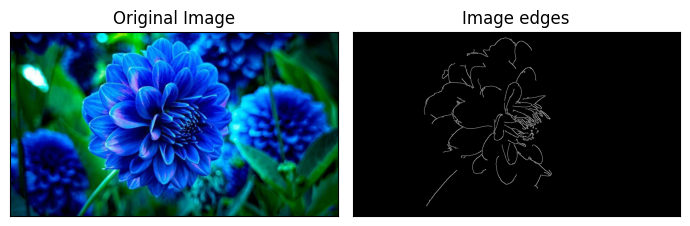

In [15]:
# Load Image
img = cv2.imread('flores.jpg')
# Convert BGR image to RGB
image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Apply Canny edge detection
edges = cv2.Canny(image= image_rgb, threshold1=100, threshold2=700)

# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(7, 4))

# Plot the original image
axs[0].imshow(image_rgb)
axs[0].set_title('Original Image')

# Plot the blurred image
axs[1].imshow(edges)
axs[1].set_title('Image edges')

# Remove ticks from the subplots
for ax in axs:
	ax.set_xticks([])
	ax.set_yticks([])

# Display the subplots
plt.tight_layout()
plt.show()


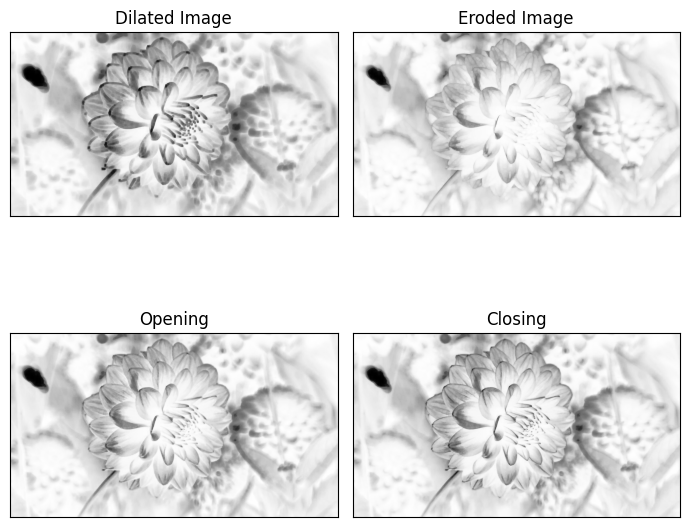

In [16]:
# Load the image
image = cv2.imread('flores.jpg')

# Convert BGR image to gray
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Create a structuring element
kernel = np.ones((3, 3), np.uint8)

# Perform dilation
dilated = cv2.dilate(image_gray, kernel, iterations=2)

# Perform erosion
eroded = cv2.erode(image_gray, kernel, iterations=2)

# Perform opening (erosion followed by dilation)
opening = cv2.morphologyEx(image_gray, cv2.MORPH_OPEN, kernel)

# Perform closing (dilation followed by erosion)
closing = cv2.morphologyEx(image_gray, cv2.MORPH_CLOSE, kernel)

# Create subplots
fig, axs = plt.subplots(2, 2, figsize=(7, 7))

# Plot the Dilated Image
axs[0,0].imshow(dilated, cmap='Greys')
axs[0,0].set_title('Dilated Image')
axs[0,0].set_xticks([])
axs[0,0].set_yticks([])

# Plot the Eroded Image
axs[0,1].imshow(eroded, cmap='Greys')
axs[0,1].set_title('Eroded Image')
axs[0,1].set_xticks([])
axs[0,1].set_yticks([])

# Plot the opening (erosion followed by dilation)
axs[1,0].imshow(opening, cmap='Greys')
axs[1,0].set_title('Opening')
axs[1,0].set_xticks([])
axs[1,0].set_yticks([])

# Plot the closing (dilation followed by erosion)
axs[1,1].imshow(closing, cmap='Greys')
axs[1,1].set_title('Closing')
axs[1,1].set_xticks([])
axs[1,1].set_yticks([])

# Display the subplots
plt.tight_layout()
plt.show()


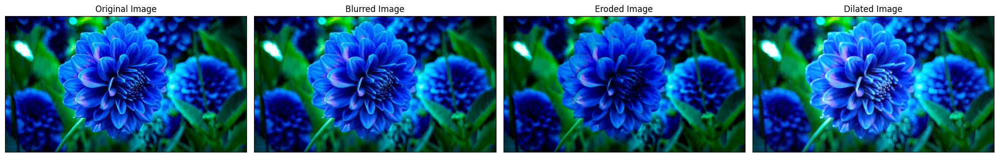

In [17]:
img = cv2.imread('flores.jpg')

blurred_img = cv2.GaussianBlur(img, (5, 5), 0)

# Se aplica erosión
kernel = np.ones((5, 5), np.uint8)
eroded_img = cv2.erode(img, kernel, iterations=1)

# Se aplica dilatación
dilated_img = cv2.dilate(img, kernel, iterations=1)

img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
blurred_img_rgb = cv2.cvtColor(blurred_img, cv2.COLOR_BGR2RGB)
eroded_img_rgb = cv2.cvtColor(eroded_img, cv2.COLOR_BGR2RGB)
dilated_img_rgb = cv2.cvtColor(dilated_img, cv2.COLOR_BGR2RGB)

fig, axs = plt.subplots(1, 4, figsize=(20, 5))

axs[0].imshow(img_rgb)
axs[0].set_title('Original Image')

axs[1].imshow(blurred_img_rgb)
axs[1].set_title('Blurred Image')

axs[2].imshow(eroded_img_rgb)
axs[2].set_title('Eroded Image')

axs[3].imshow(dilated_img_rgb)
axs[3].set_title('Dilated Image')

# Remover ticks de los subplots
for ax in axs:
    ax.set_xticks([])
    ax.set_yticks([])

# Mostrar los subplots
plt.tight_layout()
plt.show()


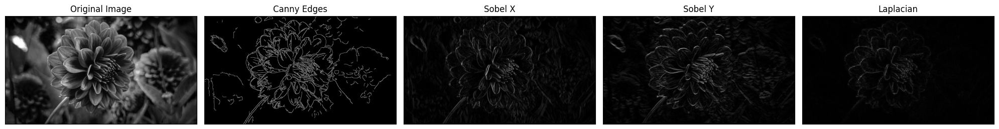

In [18]:
gray_image = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Canny para detección de bordes
edges = cv2.Canny(img, 100, 200)

# Sobel para detección de bordes
sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=5)  # Sobel X
sobely = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=5)  # Sobel Y

sobel_combined = cv2.magnitude(sobelx, sobely)

# Laplacian para detección de bordes
laplacian = cv2.Laplacian(gray_image, cv2.CV_64F)

fig, axs = plt.subplots(1, 5, figsize=(20, 5))

axs[0].imshow(gray_image, cmap='gray')
axs[0].set_title('Original Image')

axs[1].imshow(edges, cmap='gray')
axs[1].set_title('Canny Edges')

axs[2].imshow(np.abs(sobelx), cmap='gray')
axs[2].set_title('Sobel X')

axs[3].imshow(np.abs(sobely), cmap='gray')
axs[3].set_title('Sobel Y')

axs[4].imshow(np.abs(laplacian), cmap='gray')
axs[4].set_title('Laplacian')

for ax in axs:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.show()


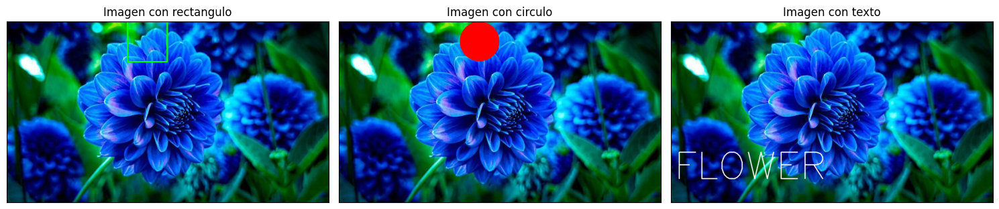

In [19]:
img_rect = img.copy()
img_circle = img.copy()
img_text = img.copy()

# Dibujar un rectángulo
cv2.rectangle(img_rect, (384, 0), (510, 128), (0, 255, 0), 3)

# Dibujar un círculo
cv2.circle(img_circle, (447, 63), 63, (0, 0, 255), -1)

# Poner texto
font = cv2.FONT_HERSHEY_SIMPLEX
cv2.putText(img_text, 'FLOWER', (10, 500), font, 4, (255, 255, 255), 2, cv2.LINE_AA)

img_rect_rgb = cv2.cvtColor(img_rect, cv2.COLOR_BGR2RGB)
img_circle_rgb = cv2.cvtColor(img_circle, cv2.COLOR_BGR2RGB)
img_text_rgb = cv2.cvtColor(img_text, cv2.COLOR_BGR2RGB)

fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(img_rect_rgb)
axs[0].set_title('Imagen con rectangulo')

axs[1].imshow(img_circle_rgb)
axs[1].set_title('Imagen con circulo')

axs[2].imshow(img_text_rgb)
axs[2].set_title('Imagen con texto')

for ax in axs:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.show()

## Video

In [22]:
# Abriendo un video y reproduciendolo

cap = cv2.VideoCapture('gato.mp4')

if not cap.isOpened():
    print("Error: No se pudo abrir el video.")
else:
    while True:
       
        ret, frame = cap.read()
    
        if not ret:
            print("No se pudo recibir el frame. Saliendo...")
            break
        
        cv2.imshow('Video gatito', frame)

        # PRESIONAR CUALQUIER TECLA PARA DETENER
        if cv2.waitKey(25) != -1:
            print("Deteniendo el video por tecla presionada")
            break
        
cap.release()
cv2.destroyAllWindows()


Deteniendo el video por tecla presionada


### Video con sonido

In [21]:
video_path = 'gato.mp4'

clip = VideoFileClip(video_path)
clip.preview()
